# 1. Spotify Dataset
The "data.csv" file contains more than 160.000 songs collected from Spotify Web API. The dataset is from Spotify and contains 169k songs from the year 1921 to year 2020. Each year got
top 100 songs.

Primary:

* id (Id of track generated by Spotify)
* Numerical:
* acousticness (Ranges from 0 to 1)
* danceability (Ranges from 0 to 1)
* energy (Ranges from 0 to 1)
* duration_ms (Integer typically ranging from 200k to 300k)
* instrumentalness (Ranges from 0 to 1)
* valence (Ranges from 0 to 1)
* popularity (Ranges from 0 to 100)
* tempo (Float typically ranging from 50 to 150)
* liveness (Ranges from 0 to 1)
* loudness (Float typically ranging from -60 to 0)
* speechiness (Ranges from 0 to 1)
* year (Ranges from 1921 to 2020)

Dummy:
* mode (0 = Minor, 1 = Major)
* explicit (0 = No explicit content, 1 = Explicit content)

Categorical:
* key (All keys on octave encoded as values ranging from 0 to 11, starting on C as 0, C# as 1 and so on…)
* artists (List of artists mentioned)
* release_date (Date of release mostly in yyyy-mm-dd format, however precision of date may vary)
* name (Name of the song)

More Information:

Some of the key attributes present in each event in the data are:
* key — The estimated overall key of the track. Integers map to pitches using standard Pitch Class notation. Ex: 0 = C, 1 = C♯/D♭, 2 = D, and so on. If no key was detected, the value is -1.
* Mode — Mode indicates the modality (major or minor) of a track, the type of scale from which its melodic content is derived. Major is represented by 1 and minor is 0.
* Acoustiness — A confidence measure from 0.0 to 1.0 of whether the track is acoustic. 1.0 represents high confidence the track is acoustic.
* Danceability — Danceability describes how suitable a track is for dancing based on a combination of musical elements including tempo, rhythm stability, beat strength, and overall regularity. A value of 0.0 is least danceable and 1.0 is the most danceable.
* Energy — Energy is a measure from 0.0 to 1.0 and represents a perceptual measure of intensity and activity. Typically, energetic tracks feel fast, loud, and noisy.
* Instrumentalness — Predicts whether a track contains no vocals. The closer the instrumentalness value is to 1.0, the greater likelihood the track contains no vocal content.
* Loudness — The overall loudness of a track in decibels (dB). Values typical range between -60 and 0 dB.
* Valence — A measure from 0.0 to 1.0 describing the musical positiveness conveyed by a track. Tracks with high valence sound more positive.
* Tempo — The overall estimated tempo of a track in beats per minute (BPM).
* Popularity — The popularity of the track. The value will be between 0 and 100, with 100 being the most popular.

In [113]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

# For validation
from sklearn.model_selection import train_test_split as split

# For transformations and predictions
from scipy.optimize import curve_fit
from sklearn.preprocessing import FunctionTransformer
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import MinMaxScaler
from sklearn.compose import ColumnTransformer

# For models
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.svm import SVC
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestClassifier

# For boosting
from sklearn.ensemble import AdaBoostClassifier

# For scoring
from sklearn.metrics import mean_squared_error as mse
from sklearn.metrics import accuracy_score

from sklearn.metrics import confusion_matrix
from sklearn.model_selection import cross_val_score
from sklearn.metrics import classification_report

# 2. Import data and cleaning 

In [114]:
## Import the dataset
df = pd.read_csv('data.csv')

## Drop unnecessary columns 
df = df.drop(["explicit", "id", "mode", "name", "release_date"], axis=1)

# Drop duplicates (there's no null values)
df = df[~df.duplicated()==1]

There are 14 features and one target variable which is 'popularity'.

In [115]:
df.tail()

,acousticness,artists,danceability,duration_ms,energy,instrumentalness,key,liveness,loudness,popularity,speechiness,tempo,valence,year
169904,0.1730,"['DripReport', 'Tyga']",0.875,163800,0.443,0.000032,1,0.0891,-7.461,75,0.1430,100.012,0.306,2020
169905,0.0167,"['Leon Bridges', 'Terrace Martin']",0.719,167468,0.385,0.031300,8,0.1110,-10.907,64,0.0403,128.000,0.270,2020
169906,0.5380,"['Kygo', 'Oh Wonder']",0.514,180700,0.539,0.002330,7,0.1080,-9.332,70,0.1050,123.700,0.153,2020
169907,0.0714,"['Cash Cash', 'Andy Grammer']",0.646,167308,0.761,0.000000,1,0.2220,-2.557,70,0.0385,129.916,0.472,2020
169908,0.1090,['Ingrid Andress'],0.512,214787,0.428,0.000000,0,0.1050,-7.387,65,0.0271,80.588,0.366,2020


## 2.1 Adding a new column 
I chose these labels based partially on concentrations found in the data, but mostly the choices were made based on intuition. Below is the code to set up and inspect the new column specifying the labels.

In [116]:
classified = df.copy()
classified['pop_rating'] = ''

for i, row in classified.iterrows():
    score = 'unpopular'
    if (row.popularity > 50) & (row.popularity < 75):
        score = 'medium'
    elif row.popularity >= 75:
        score = 'popular'
    classified.at[i, 'pop_rating'] = score

The different classes in the classified dataset exhibit a high level of imbalance. This needs to be accounted for in order to ensure the models perform as well as possible. Here's a visualization of the disparity.

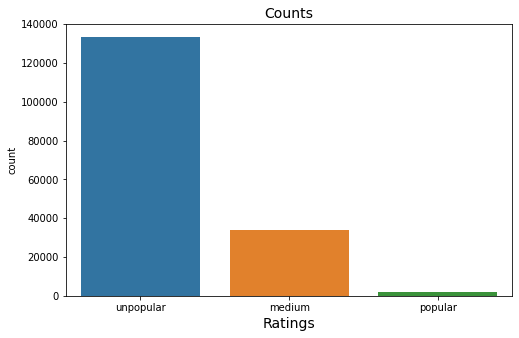

In [117]:
fig, ax = plt.subplots(1,1, figsize=(8,5))
_ = sns.countplot(x='pop_rating', data=classified)
_ = plt.xlabel('Ratings', fontsize=14)
_ = plt.title('Counts', fontsize=14)

# 3 EDA - Correlations
### 3.1 Finding the correlation between all of the numerical features.
We can now examine the rest of the features and see how they correlate with each other, in particular how they correlate with the popularity column.
A heatmap is a graphical representation of data where each value of a matrix is represented as a color.

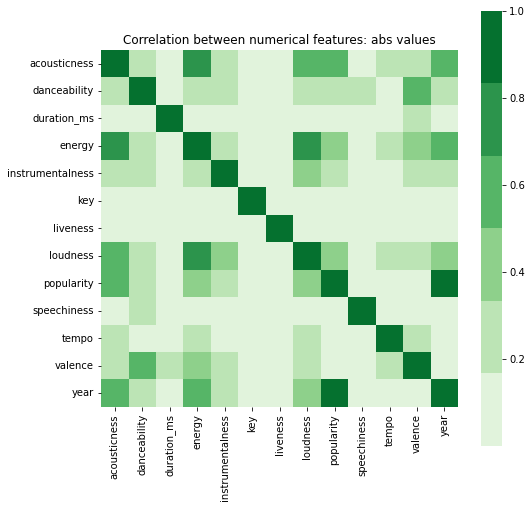

In [118]:
numeric_columns = df.columns[df.dtypes != 'object']
numeric_df = pd.DataFrame(data=df, columns=numeric_columns, index=df.index)

corr = np.abs(numeric_df.corr())
fig, ax = plt.subplots(figsize=(8, 8))
cmap = sns.color_palette("Greens")
sns.heatmap(corr, cmap=cmap, square=True)
plt.title('Correlation between numerical features: abs values')
plt.show()

### 3.2 The most linear correlated features to POPULARITY
The following code creates the correlation matrix between all the features we are examining and our y-variable.
As we can see down below, the 'popularity' have a strong correlation with 'year', 'loudness' and 'energy'...

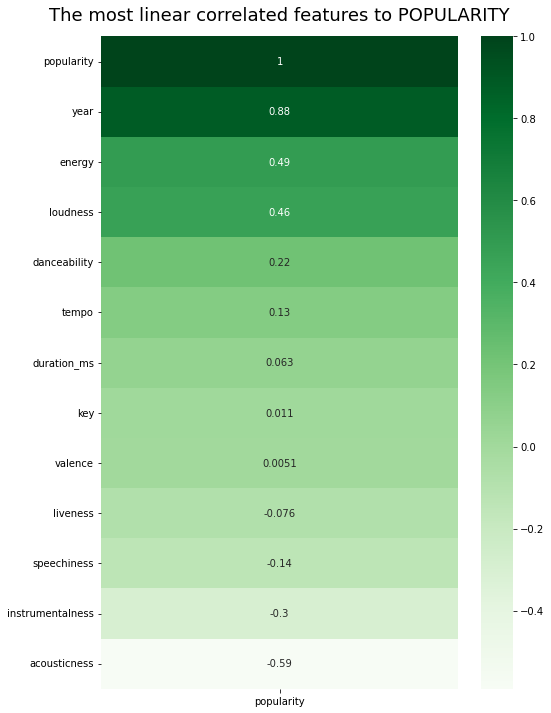

In [119]:
corr = numeric_df.corr()[['popularity']].sort_values(by='popularity', ascending=False)
plt.figure(figsize=(8, 12))
heatmap = sns.heatmap(corr, annot=True, cmap='Greens')
heatmap.set_title('The most linear correlated features to POPULARITY', fontdict={'fontsize':18}, pad=16);

### 3.3 Year
* From the heatmap above, the correlation between popularity and year is strong, which makes sense, since popularity is mostly new music.
* The year attribute is linearly close to the popularity target (corr = 0.88)
* Due to the very high linear correlation between the year and the popularity, this feature will be excluded from our models.

As expected, popularity is highly correlated with the year released. This makes sense as the Spotify algorithm which makes this decision generates its “popularity” metric by not just how many streams a song receives, but also how recent those streams are.

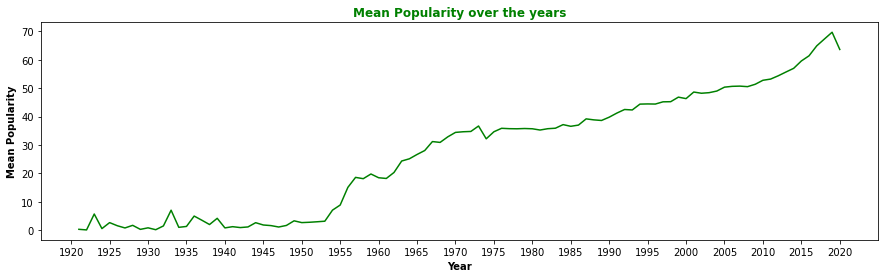

In [120]:
fig, ax = plt.subplots(figsize=(15, 4))
ax = df.groupby('year')['popularity'].mean().plot(color='green')
ax.set_title('Mean Popularity over the years', c='green', weight='bold')
ax.set_ylabel('Mean Popularity', weight='bold')
ax.set_xlabel('Year', weight='bold')
ax.set_xticks(range(1920, 2021, 5))
plt.show()

In [121]:
def regress_plot(x='', y='', data=None, xlab='', ylab='', titl=''):
    '''Plots a scatterplot with a regression line
    using given inputs'''
    data = data.groupby(x)[y].mean().to_frame().reset_index()
    fig, ax = plt.subplots(figsize=(10,6))
    _ = sns.regplot(x=x, y=y, data=data, scatter_kws={'color': 'g', "s": 10}, line_kws={'color':'black'} )
    _ = plt.xlabel(xlab, fontsize=12)
    _ = plt.ylabel(ylab, fontsize=12)
    _ = plt.title(titl, fontsize=14, c='green')
    _ = plt.ylim(-3, 103)
    plt.show()

### 3.4 Energy - (ranges from 0 to 1)
* Measure the intensity and activity, energetic track feels faster, louder and noisier.
* It seems that there is a releativly strong linear correlation of 0.497 correlation to the target.
* From the correlation heatmap, the best predictor seemed to be energy. 

Energy also seems to influence a song’s popularity. Many popular songs are energetic, though not necessarily dance songs. Because the correlation here is not too high, low energy songs do have some potential to be more popular.

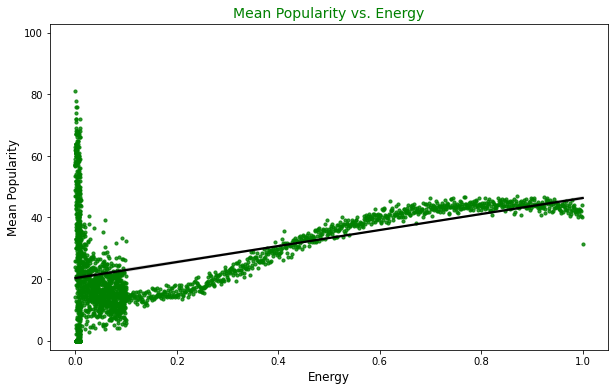

In [122]:
regress_plot(x='energy', y='popularity', data=df, xlab='Energy', ylab='Mean Popularity', titl='Mean Popularity vs. Energy')

### 3.5 Loudness  - float typically ranging from (-60 to 0)
The regressor clearly shows there is a positive correlation, and the data tends to narrow towards the top, but overall the observations are quite scattered. It's not a very strong fit.
Loudness and energy are highly correlated. This makes some sense as energy is definitely influenced by the volume at which the music is being played.

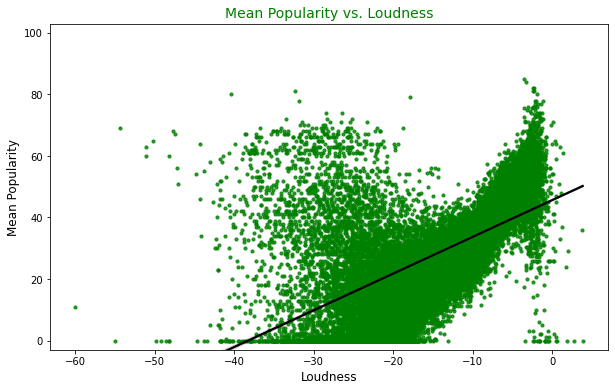

In [123]:
regress_plot(x='loudness', y='popularity', data=df, xlab='Loudness', ylab='Mean Popularity', titl='Mean Popularity vs. Loudness')

### 3.6 Danceability - (ranges from 0 to 1)
* Danceability- measure if the song is dancable based on the combination of tempo rythm and beat strength
* Danceability seems to have a normal distribution between 0-1
* the majoirity of Danceability values is between 0.2-0.8 with mean 0.53

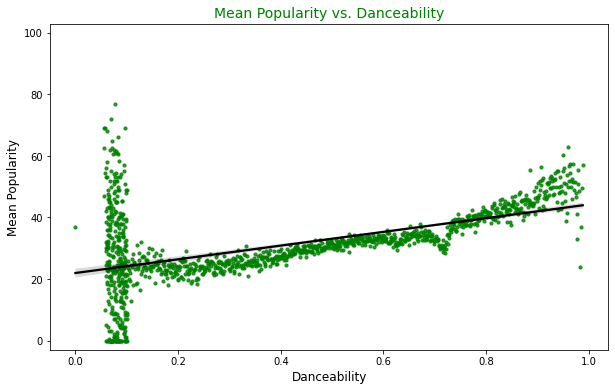

In [124]:
regress_plot(x='danceability', y='popularity', data=df, xlab='Danceability', ylab='Mean Popularity', titl='Mean Popularity vs. Danceability')

### 3.7 Tempo - (float typically ranging from 50 to 150)

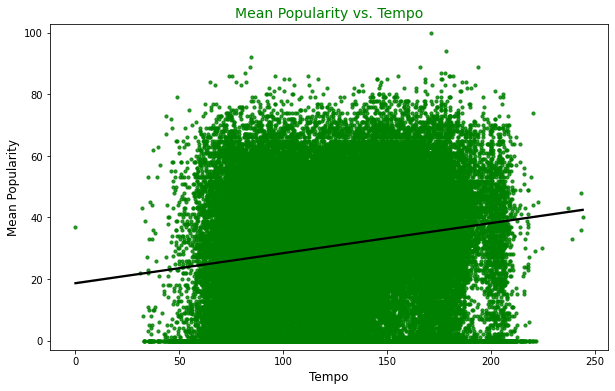

In [125]:
regress_plot(x='tempo', y='popularity', data=df, xlab='Tempo', ylab='Mean Popularity', titl='Mean Popularity vs. Tempo')

### 3.8 Acousticness 
Acoustiness seems to be uncorrelated with popularity. Most popular songs today have either electronic or electric instruments in them. It is very rare that a piece of music played by a chamber orchestra or purely acoustic band becomes immensely popular

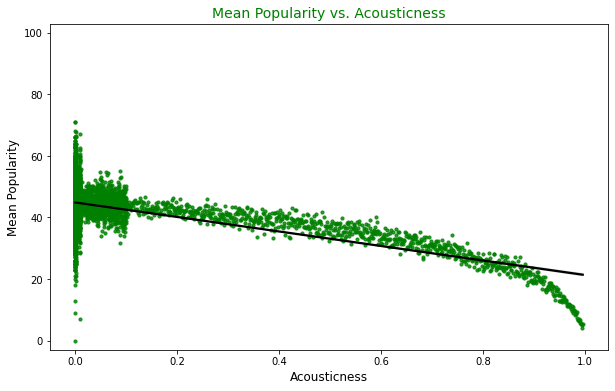

In [126]:
regress_plot(x='acousticness', y='popularity', data=df, xlab='Acousticness', ylab='Mean Popularity', titl='Mean Popularity vs. Acousticness')

### 3.9 In general
Unpopular songs and popular songs can have many similarities, and all popular songs can have many differences. The purpose of this project is to see if an algorithm can sort out these differences and similarities better than a human could.

Thus, from this data, it would be better for an artist to create a high energy song with either electric instruments or electronic songs to have the best chance of generating the most popularity.

We need to design an ML Model that can predict the Popularity based on the features available.
The chart shows five features are with negative correlation and seven features with positive correlation.

# 4. **Pre-Processing**
* Import data with relevant columns only
* Remove duplicates
* Split data to train & test

In [127]:
## Import the dataset
df = pd.read_csv('data.csv')

### 4.1 Data Cleaning - (Data Imputation)

#### 4.1.1 Drop Duplicates

In [128]:
# Remove duplicated
df = df[~df.duplicated()==1]

#### 4.1.2 Convert Duration

In [129]:
# Transform milliseconds to minutes
df["duration_mins"] = df["duration_ms"]/60000
df.drop(columns="duration_ms", inplace=True)

In [130]:
#Remove the Square Brackets from the artists

df["artists"]=df["artists"].str.replace("[", "")
df["artists"]=df["artists"].str.replace("]", "")
df["artists"]=df["artists"].str.replace("'", "")

C:\Users\egork\AppData\Local\Temp/ipykernel_24876/1812086661.py:3: FutureWarning: The default value of regex will change from True to False in a future version. In addition, single character regular expressions will *not* be treated as literal strings when regex=True.
  df["artists"]=df["artists"].str.replace("[", "")
C:\Users\egork\AppData\Local\Temp/ipykernel_24876/1812086661.py:4: FutureWarning: The default value of regex will change from True to False in a future version. In addition, single character regular expressions will *not* be treated as literal strings when regex=True.
  df["artists"]=df["artists"].str.replace("]", "")


## Prepare

In [131]:
data = df.copy()

data.loc[((df.popularity >= 0) & (df.popularity <= 30)), "popularity_level" ] = 1
data.loc[((df.popularity > 30) & (df.popularity <= 60)), "popularity_level" ] = 2
data.loc[((df.popularity > 60) & (df.popularity <= 100)), "popularity_level" ] = 3

data["popularity_level"] = data["popularity_level"].astype("int")

data.head(10)

,acousticness,artists,danceability,energy,explicit,id,instrumentalness,key,liveness,loudness,mode,name,popularity,release_date,speechiness,tempo,valence,year,duration_mins,popularity_level
0,0.995,Carl Woitschach,0.708,0.1950,0,6KbQ3uYMLKb5jDxLF7wYDD,0.563,10,0.1510,-12.428,1,Singende Bataillone 1. Teil,0,1928,0.0506,118.469,0.7790,1928,2.644133,1
1,0.994,"Robert Schumann, Vladimir Horowitz",0.379,0.0135,0,6KuQTIu1KoTTkLXKrwlLPV,0.901,8,0.0763,-28.454,1,"Fantasiestücke, Op. 111: Più tosto lento",0,1928,0.0462,83.972,0.0767,1928,4.702217,1
2,0.604,Seweryn Goszczyński,0.749,0.2200,0,6L63VW0PibdM1HDSBoqnoM,0.000,5,0.1190,-19.924,0,Chapter 1.18 - Zamek kaniowski,0,1928,0.9290,107.177,0.8800,1928,1.738333,1
3,0.995,Francisco Canaro,0.781,0.1300,0,6M94FkXd15sOAOQYRnWPN8,0.887,1,0.1110,-14.734,0,Bebamos Juntos - Instrumental (Remasterizado),0,1928-09-25,0.0926,108.003,0.7200,1928,3.012667,1
4,0.990,"Frédéric Chopin, Vladimir Horowitz",0.210,0.2040,0,6N6tiFZ9vLTSOIxkj8qKrd,0.908,11,0.0980,-16.829,1,"Polonaise-Fantaisie in A-Flat Major, Op. 61",1,1928,0.0424,62.149,0.0693,1928,11.462217,1
5,0.995,"Felix Mendelssohn, Vladimir Horowitz",0.424,0.1200,0,6NxAf7M8DNHOBTmEd3JSO5,0.911,6,0.0915,-19.242,0,Scherzo a capriccio: Presto,0,1928,0.0593,63.521,0.2660,1928,5.876667,1
6,0.956,"Franz Liszt, Vladimir Horowitz",0.444,0.1970,0,6O0puPuyrxPjDTHDUgsWI7,0.435,11,0.0744,-17.226,1,"Valse oubliée No. 1 in F-Sharp Major, S. 215/1",0,1928,0.0400,80.495,0.3050,1928,2.277117,1
7,0.988,Carl Woitschach,0.555,0.4210,0,6OJjveoYwJdIt76y0Pxpxw,0.836,1,0.1050,-9.878,1,Per aspera ad astra,0,1928,0.0474,123.310,0.8570,1928,2.566117,1
8,0.995,"Francisco Canaro, Charlo",0.683,0.2070,0,6OaJ8Bh7lsBeYoBmwmo2nh,0.206,9,0.3370,-9.801,0,Moneda Corriente - Remasterizado,0,1928-10-03,0.1270,119.833,0.4930,1928,2.708217,1
9,0.846,Seweryn Goszczyński,0.674,0.2050,0,6PrZexNb16cabXR8Q418Xc,0.000,9,0.1700,-20.119,1,Chapter 1.3 - Zamek kaniowski,0,1928,0.9540,81.249,0.7590,1928,1.860000,1


In [132]:
data['popularity_level'].value_counts()

2    77568
1    76724
3    15617
Name: popularity_level, dtype: int64

### 4.2 Example cases

In [133]:
artists = ['Drake', 'Lady Gaga', 'Taylor Swift', 'The Weeknd']

# Create a list of indices corresponding to the artists above
# The first comprehension creates a list of lists, the second flattens it into one
to_drop = [data[data.artists == name].index.tolist() for name in artists]
to_drop = [ind for sub in to_drop for ind in sub]

# Gather the test cases
df_x = data.copy()
cases = df_x[df_x.index.isin(to_drop)]

# Remove the test cases from data
data.drop(to_drop, inplace=True)

## Drop unnecessary columns 
data = data.drop(["popularity", "explicit", "id", "mode", "name", "release_date", "artists"], axis=1)

data.head()

,acousticness,danceability,energy,instrumentalness,key,liveness,loudness,speechiness,tempo,valence,year,duration_mins,popularity_level
0,0.995,0.708,0.1950,0.563,10,0.1510,-12.428,0.0506,118.469,0.7790,1928,2.644133,1
1,0.994,0.379,0.0135,0.901,8,0.0763,-28.454,0.0462,83.972,0.0767,1928,4.702217,1
2,0.604,0.749,0.2200,0.000,5,0.1190,-19.924,0.9290,107.177,0.8800,1928,1.738333,1
3,0.995,0.781,0.1300,0.887,1,0.1110,-14.734,0.0926,108.003,0.7200,1928,3.012667,1
4,0.990,0.210,0.2040,0.908,11,0.0980,-16.829,0.0424,62.149,0.0693,1928,11.462217,1


In [134]:
# Prepare data for prediction
data.drop(data[data['popularity_level']==2].index[0:60000],inplace=True)
data.drop(data[data['popularity_level']==1].index[0:60000],inplace=True)
data


,acousticness,danceability,energy,instrumentalness,key,liveness,loudness,speechiness,tempo,valence,year,duration_mins,popularity_level
5085,0.780000,0.5540,0.330000,0.000003,3,0.1070,-10.866,0.0300,128.214,0.29700,1990,4.013333,3
5549,0.290000,0.7490,0.662000,0.000014,4,0.3550,-7.585,0.0468,126.998,0.74000,1994,3.976217,3
5683,0.030900,0.4900,0.418000,0.000020,2,0.0615,-10.773,0.0572,98.507,0.22600,1996,4.654450,3
6167,0.538000,0.5850,0.702000,0.000000,0,0.2160,-5.734,0.0325,139.909,0.51000,2001,3.358883,3
6235,0.018000,0.5080,0.826000,0.000000,1,0.2800,-4.088,0.0405,120.854,0.40400,2001,3.417783,3
6240,0.028500,0.8220,0.672000,0.000000,7,0.2130,-6.133,0.0329,117.033,0.91000,2001,3.893783,3
6242,0.246000,0.6060,0.913000,0.006960,8,0.3400,-6.039,0.0351,123.580,0.83800,2001,4.443333,3
6330,0.076500,0.5450,0.943000,0.010600,0,0.0442,-5.400,0.0875,190.053,0.69400,2002,3.443333,3
6420,0.000820,0.3010,0.571000,0.800000,8,0.0851,-10.152,0.0332,178.084,0.04120,2003,5.266450,3
6425,0.083100,0.6220,0.818000,0.000000,9,0.3100,-6.784,0.0327,138.495,0.84900,2003,3.470000,3


In [135]:
data.head()

,acousticness,danceability,energy,instrumentalness,key,liveness,loudness,speechiness,tempo,valence,year,duration_mins,popularity_level
5085,0.7800,0.554,0.330,0.000003,3,0.1070,-10.866,0.0300,128.214,0.297,1990,4.013333,3
5549,0.2900,0.749,0.662,0.000014,4,0.3550,-7.585,0.0468,126.998,0.740,1994,3.976217,3
5683,0.0309,0.490,0.418,0.000020,2,0.0615,-10.773,0.0572,98.507,0.226,1996,4.654450,3
6167,0.5380,0.585,0.702,0.000000,0,0.2160,-5.734,0.0325,139.909,0.510,2001,3.358883,3
6235,0.0180,0.508,0.826,0.000000,1,0.2800,-4.088,0.0405,120.854,0.404,2001,3.417783,3


In [136]:
y = data['popularity_level']
X = data.drop(columns=['popularity_level'])
X_train, X_test, y_train, y_test = split(X, y, test_size = 0.25, random_state = 42)

### 4.2 Feature Transformations
Steps followed in Feature Transformation are:
* Object data of the artists with some numerical indicator that identify the artist.
* Eliminate Zero values from tempo columns and replace it
* Standardizing Instrumental Criteria with numeric values
* Using OneHotEncoder from SKlearn to create dummies
* Minmax Scaling for relevant features
* Target Scaling for Popularity Column


* A one hot encoding is a representation of categorical variables as binary vectors.
* This first requires that the categorical values be mapped to integer values.
* Then, each integer value is represented as a binary vector that is all zero values except the index of the integer, which is marked with a 1.
* we would like to give the network more expressive power to learn a probability-like number for each possible label value. This can help in both making the problem easier for the network to model. When a one hot encoding is used for the output variable, it may offer a more nuanced set of predictions than a single label.

In [137]:
# Transform features by scaling specific features to a given range
ctr = ColumnTransformer([('minmax', MinMaxScaler(), ['year', 'tempo', 'duration_mins']),
                        ('categorical', OneHotEncoder(), ['key'])],
                       remainder='passthrough')

In [138]:
ctr .fit(X_train)
X_train_preprocessed = ctr .transform(X_train)
X_test_preprocessed = ctr .transform(X_test)

# 5. Modeling

* Decision Tree
* Nearest Neighbors Classifier
* Logistic Regression
* Adaboost Classifier
* RandomForestClassifier

In [139]:
results = []

def run_model(model, alg_name):
   # build the model on training data
   model.fit(X_train, y_train)
 
   # make predictions for test data
   y_pred = model.predict(X_test)
   # calculate the accuracy score
   accuracy =  accuracy_score(y_test, y_pred)
   cm = confusion_matrix(y_test, y_pred)
   scoresDT3 = cross_val_score(model, X_test, y_test, cv=6)
   Cr = classification_report(y_test, y_pred)
   results.append((alg_name, accuracy, model))
   print("Model: ", alg_name)
   print("Accuracy on Test Set for {} = {:.2f}\n".format(alg_name,accuracy))
   print(Cr)
   print("{}: CrossVal Accuracy Mean: {:.2f} and Standard Deviation: {:.2f} \n".format(alg_name,scoresDT3.mean(), scoresDT3.std()))

### 5.1 Decision Tree Classifier
To start off simple, I first ran a basic decision tree classifier. This only generates one tree so it's not computationally intensive, but it's also susceptible to overfitting.

In [140]:
model = DecisionTreeClassifier()
run_model(model, "Decision Tree")

Model:  Decision Tree
Accuracy on Test Set for Decision Tree = 0.75

              precision    recall  f1-score   support

           1       0.89      0.90      0.90      4147
           2       0.67      0.65      0.66      4338
           3       0.67      0.69      0.68      3869

    accuracy                           0.75     12354
   macro avg       0.74      0.75      0.74     12354
weighted avg       0.75      0.75      0.75     12354

Decision Tree: CrossVal Accuracy Mean: 0.74 and Standard Deviation: 0.01 



### 5.2 Nearest Neighbors Classifier
To start off simple, I first ran a basic decision tree classifier. This only generates one tree so it's not computationally intensive, but it's also susceptible to overfitting.

In [141]:
model = KNeighborsClassifier()
run_model(model, "Nearest Neighbors Classifier")

Model:  Nearest Neighbors Classifier
Accuracy on Test Set for Nearest Neighbors Classifier = 0.79

              precision    recall  f1-score   support

           1       0.92      0.92      0.92      4147
           2       0.70      0.77      0.74      4338
           3       0.77      0.68      0.72      3869

    accuracy                           0.79     12354
   macro avg       0.80      0.79      0.79     12354
weighted avg       0.80      0.79      0.79     12354

Nearest Neighbors Classifier: CrossVal Accuracy Mean: 0.79 and Standard Deviation: 0.00 



### 5.3 Logisitic Regression

In [142]:
model = LogisticRegression(multi_class='multinomial' , solver='lbfgs', max_iter=100)
run_model(model, "Logistic Regression")

C:\Users\egork\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.9_qbz5n2kfra8p0\LocalCache\local-packages\Python39\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\egork\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.9_qbz5n2kfra8p0\LocalCache\local-packages\Python39\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/m

Model:  Logistic Regression
Accuracy on Test Set for Logistic Regression = 0.58

              precision    recall  f1-score   support

           1       0.66      0.69      0.67      4147
           2       0.52      0.41      0.46      4338
           3       0.54      0.64      0.59      3869

    accuracy                           0.58     12354
   macro avg       0.57      0.58      0.57     12354
weighted avg       0.57      0.58      0.57     12354

Logistic Regression: CrossVal Accuracy Mean: 0.57 and Standard Deviation: 0.01 



C:\Users\egork\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.9_qbz5n2kfra8p0\LocalCache\local-packages\Python39\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


### 5.4 Adaboost Classifier

In [143]:
dt_b = DecisionTreeClassifier(max_depth=1, random_state=42)
model = AdaBoostClassifier(base_estimator=dt_b)
run_model(model, "Adaboost Classifier")

Model:  Adaboost Classifier
Accuracy on Test Set for Adaboost Classifier = 0.77

              precision    recall  f1-score   support

           1       0.96      0.92      0.94      4147
           2       0.69      0.68      0.69      4338
           3       0.68      0.74      0.71      3869

    accuracy                           0.77     12354
   macro avg       0.78      0.78      0.78     12354
weighted avg       0.78      0.77      0.78     12354

Adaboost Classifier: CrossVal Accuracy Mean: 0.76 and Standard Deviation: 0.01 



### 5.5 Random Forest Classifier

In [144]:
model = RandomForestClassifier(n_estimators=10)
run_model(model, "Random Forest")

Model:  Random Forest
Accuracy on Test Set for Random Forest = 0.81

              precision    recall  f1-score   support

           1       0.95      0.92      0.93      4147
           2       0.70      0.85      0.76      4338
           3       0.82      0.64      0.72      3869

    accuracy                           0.81     12354
   macro avg       0.82      0.80      0.81     12354
weighted avg       0.82      0.81      0.81     12354

Random Forest: CrossVal Accuracy Mean: 0.81 and Standard Deviation: 0.01 



# 6. Results

In [145]:
from tabulate import tabulate

print("Classification Results")
rows = list()

for res in results:
    rows.append([res[0], res[1] ])
    
tab = tabulate(rows, headers=['Algorithm', 'Accuracy'], tablefmt='fancy_grid')
print(tab)

Classification Results
╒══════════════════════════════╤════════════╕
│ Algorithm                    │   Accuracy │
╞══════════════════════════════╪════════════╡
│ Decision Tree                │   0.745427 │
├──────────────────────────────┼────────────┤
│ Nearest Neighbors Classifier │   0.79367  │
├──────────────────────────────┼────────────┤
│ Logistic Regression          │   0.575765 │
├──────────────────────────────┼────────────┤
│ Adaboost Classifier          │   0.77481  │
├──────────────────────────────┼────────────┤
│ Random Forest                │   0.807188 │
╘══════════════════════════════╧════════════╛


### 6.1 Example cases


In [149]:
cases_mix = cases.sample(frac=1.0, random_state=42).reset_index(drop=True)
cases_mix
cases_drop = cases_mix.drop(['artists', 'name', 'popularity', 'id',  'release_date'], axis=1)
cases_enc = pd.get_dummies(cases_drop, columns=['mode'])

cases_X = cases_enc.drop(['popularity_level', 'mode_0', 'mode_1', 'explicit'], axis=1)
cases_y = cases_mix[['popularity_level']]

cases_pred = pd.DataFrame(results[4][2].predict(cases_X), columns=['popularity_rate'])

In [150]:
pd.set_option('display.max_rows', df.shape[0]+1)
res = pd.concat([cases_mix, cases_pred], axis=1)
res.iloc[:,[1,11,12,19,20]]

,artists,name,popularity,popularity_level,popularity_rate
0,The Weeknd,Montreal,56,2,3
1,Drake,6PM In New York,55,2,3
2,Drake,The Ride,55,2,2
3,Drake,In My Feelings,81,3,3
4,Taylor Swift,A Place in this World,49,2,3
5,Lady Gaga,Applause,72,3,3
6,Drake,Headlines,72,3,2
7,Lady Gaga,Monster,44,2,3
8,Drake,Right Hand,62,3,3
9,The Weeknd,House Of Balloons / Glass Table Girls,48,2,2
